In [2]:
import torch
import numpy as np
import pandas as pd
import networkx as nx
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import spearmanr, pearsonr
import itertools

In [3]:
# Load the modified dataset
dataset_path = "precalculated_features_network_criticality.pt"
graphs = torch.load(dataset_path, weights_only=False)

In [7]:
# Prepare data
all_feature_rows = []
all_criticality = []
degree_rows = []
clustering_rows = []
pagerank_rows = []
betweenness_rows = []
eigenvector_rows = []
closeness_rows = []
core_number_rows = []

print(graphs[0])

for graph in graphs:
    if 'features' not in graph:
        continue

    G = nx.from_graph6_bytes(graph['graph6'].encode())
    edge_list = graph['edge_index']
    edge_list = np.array(edge_list).T

    degree_rows.extend(graph['features']['degree'])
    clustering_rows.extend(graph['features']['clustering'])
    pagerank_rows.extend(graph['features']['pagerank'])
    betweenness_rows.extend(graph['features']['betweenness'])
    eigenvector_rows.extend(graph['features']['eigenvector'])
    closeness_rows.extend(graph['features']['closeness'])
    core_number_rows.extend(graph['features']['core number'])
    

{'graph_id': 4, 'graph6': '>>graph6<<CN', 'edge_index': [(0, 3), (1, 2), (1, 3), (2, 3)], 'network_criticality': [0.611, -0.444, -0.611, -0.611], 'features': {'degree': [1, 2, 2, 3], 'clustering': [0, 1.0, 1.0, 0.3333333333333333], 'pagerank': [0.1414087555444403, 0.2459279727012903, 0.2459279727012903, 0.3667352990529791], 'betweenness': [0.0, 0.0, 0.0, 0.6666666666666666], 'eigenvector': [0.28184519885486814, 0.5227207256439812, 0.5227207256439816, 0.6116284573553774], 'closeness': [0.6, 0.75, 0.75, 1.0], 'core number': [1, 2, 2, 2]}}


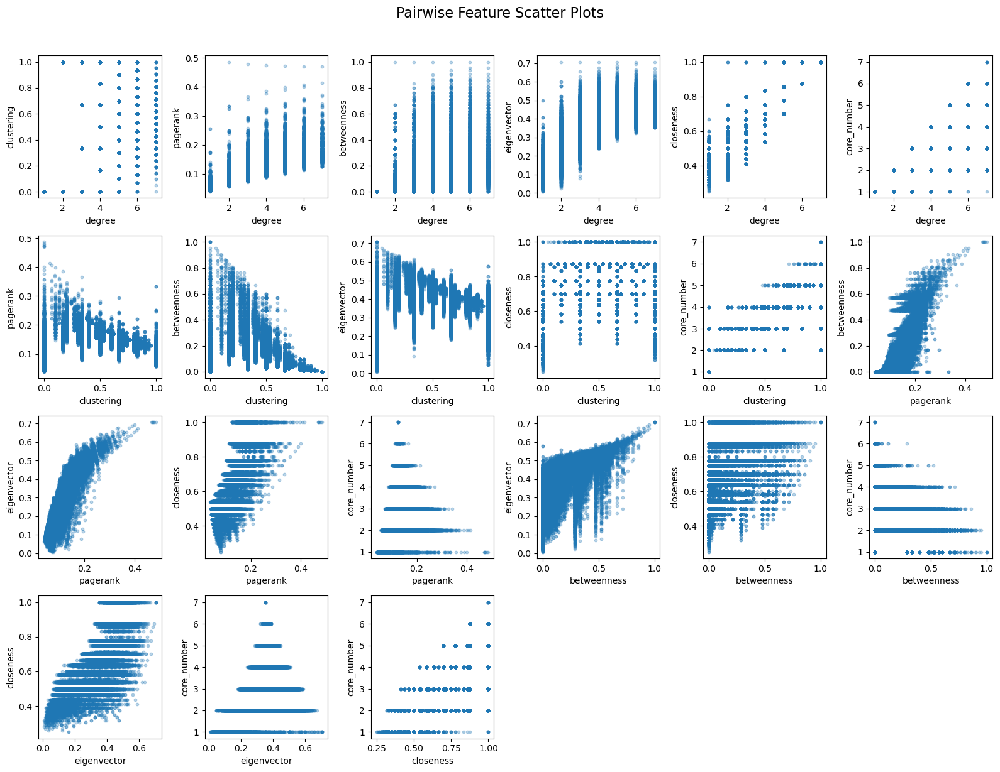

In [8]:
features = {
    "degree": degree_rows,
    "clustering": clustering_rows,
    "pagerank": pagerank_rows,
    "betweenness": betweenness_rows,
    "eigenvector": eigenvector_rows,
    "closeness": closeness_rows,
    "core_number": core_number_rows
}

# Generate all feature combinations (scatter matrix)
feature_names = list(features.keys())
combinations = list(itertools.combinations(feature_names, 2))

plt.figure(figsize=(16, 12))
for i, (feat_x, feat_y) in enumerate(combinations, 1):
    plt.subplot(4, 6, i)
    plt.scatter(features[feat_x], features[feat_y], alpha=0.3, s=10)
    plt.xlabel(feat_x)
    plt.ylabel(feat_y)
    plt.tight_layout()

plt.suptitle("Pairwise Feature Scatter Plots", fontsize=16, y=1.02)
plt.tight_layout()
plt.show()

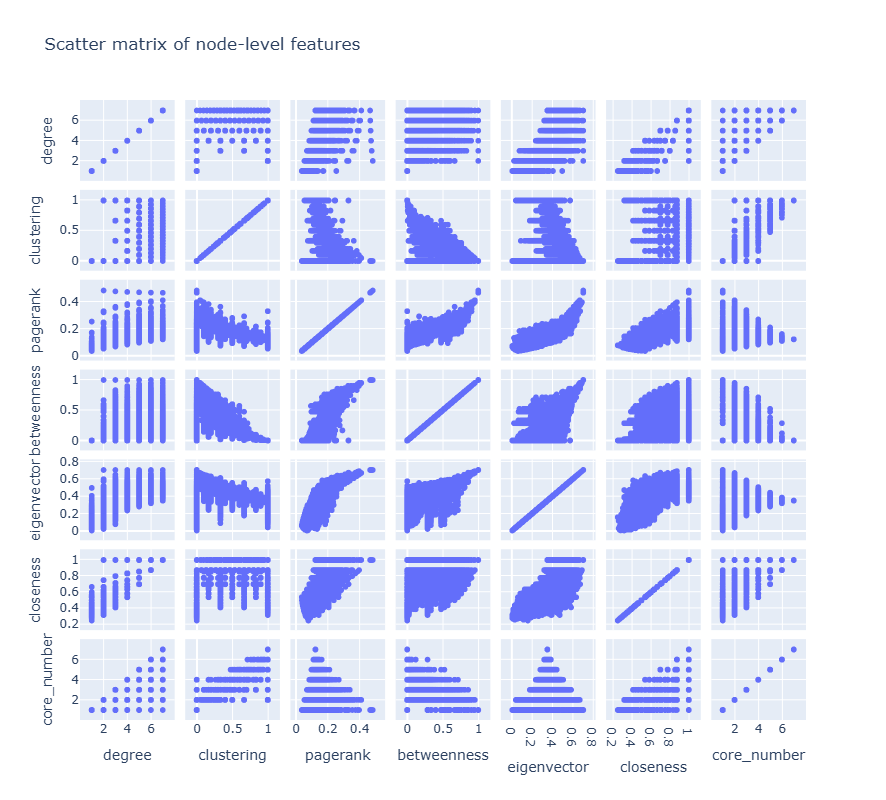

In [25]:
import pandas as pd
import plotly.express as px

# Optional: add a label column for coloring (e.g., bin by degree or graph_id)
# df["graph_id"] = [...]
df = pd.DataFrame(features)
# Create interactive scatter matrix
fig = px.scatter_matrix(
    df,
    dimensions=df.columns,  # or subset like ['degree', 'clustering', ...]
    title="Scatter matrix of node-level features",
    height=800,
    width=800
)

# fig.update_traces(diagonal_visible=False)  # optional
fig.show()
